## first testing file

In [1]:
#import needed libraries
import pandas as pd
import rdkit
from rdkit import Chem
from rdkit.Chem import AllChem
from rdkit.Chem import Draw
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

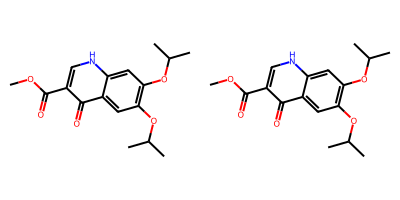

In [2]:
#test printing molecule
smiles = ['COC(=O)c1c[nH]c2cc(OC(C)C)c(OC(C)C)cc2c1=O', "COC(=O)c1c[nH]c2cc(OC(C)C)c(OC(C)C)cc2c1=O"]

mols = [Chem.MolFromSmiles(smi) for smi in smiles]
Draw.MolsToGridImage(mols, molsPerRow=2, subImgSize=(200, 200))

In [3]:
#import data
data_raw = pd.read_csv('../data/tested_molecules.csv')
data_raw

,SMILES,PKM2_inhibition,ERK2_inhibition
0,C=C(C)c1nc(N)nc(N)n1,0,0
1,C=C(Cl)COc1ccc2c(C)cc(=O)oc2c1,0,0
2,C=CCNC(=O)CCCC(=O)NCC=C,0,0
3,C=CCOn1c(=O)c(C)[n+]([O-])c2ccccc21,0,0
4,C=CCn1cc(Cl)c(=O)n(CC=C)c1=O,0,0
...,...,...,...
1111,O=C1c2ccccc2[C@H](Nc2ccc3c(c2)OCCO3)N1Cc1ccco1,0,1
1112,O=S(=O)(Nc1cccc(-c2cn3ccsc3[nH+]2)c1)c1ccc(F)cc1,0,1
1113,Oc1c(C[NH+]2CCN(c3ccccn3)CC2)cc(Cl)c2cccnc12,0,1
1114,c1ccc(-c2csc(N3CCN(c4ccccn4)CC3)n2)cc1,0,1


In [5]:
# Create dataframe

from main_v1 import create_dataframe

expanded_df = create_dataframe(data_raw)
expanded_df.head()

,SMILES,PKM2_inhibition,ERK2_inhibition,MaxAbsEStateIndex,MaxEStateIndex,MinAbsEStateIndex,MinEStateIndex,qed,SPS,MolWt,...,Bit_1014,Bit_1015,Bit_1016,Bit_1017,Bit_1018,Bit_1019,Bit_1020,Bit_1021,Bit_1022,Bit_1023
0,C=C(C)c1nc(N)nc(N)n1,0,0,5.313889,5.313889,0.120833,0.120833,0.592228,9.545455,151.173,...,0,0,0,1,0,0,0,0,1,0
1,C=C(Cl)COc1ccc2c(C)cc(=O)oc2c1,0,0,11.238954,11.238954,0.225308,-0.366756,0.785414,10.470588,250.681,...,0,0,0,0,0,0,0,0,1,0
2,C=CCNC(=O)CCCC(=O)NCC=C,0,0,11.090706,11.090706,0.049610,-0.049610,0.581062,9.066667,210.277,...,0,0,0,0,0,0,0,0,0,0
3,C=CCOn1c(=O)c(C)[n+]([O-])c2ccccc21,0,0,11.892238,11.892238,0.076632,-0.457824,0.441090,10.411765,232.239,...,0,0,0,0,0,0,0,0,0,0
4,C=CCn1cc(Cl)c(=O)n(CC=C)c1=O,0,0,11.693580,11.693580,0.012315,-0.498260,0.720343,9.933333,226.663,...,0,0,0,0,0,0,0,0,0,0


In [6]:
# verwijderen van PKM2_inhibition en ERK2_inhibition, want dit zijn de labels en dit is enkel nodig om het deep learning model te trainen
expanded_df = expanded_df.drop(columns = ['PKM2_inhibition','ERK2_inhibition'])
expanded_df

,SMILES,MaxAbsEStateIndex,MaxEStateIndex,MinAbsEStateIndex,MinEStateIndex,qed,SPS,MolWt,HeavyAtomMolWt,ExactMolWt,...,Bit_1014,Bit_1015,Bit_1016,Bit_1017,Bit_1018,Bit_1019,Bit_1020,Bit_1021,Bit_1022,Bit_1023
0,C=C(C)c1nc(N)nc(N)n1,5.313889,5.313889,0.120833,0.120833,0.592228,9.545455,151.173,142.101,151.085795,...,0,0,0,1,0,0,0,0,1,0
1,C=C(Cl)COc1ccc2c(C)cc(=O)oc2c1,11.238954,11.238954,0.225308,-0.366756,0.785414,10.470588,250.681,239.593,250.039672,...,0,0,0,0,0,0,0,0,1,0
2,C=CCNC(=O)CCCC(=O)NCC=C,11.090706,11.090706,0.049610,-0.049610,0.581062,9.066667,210.277,192.133,210.136828,...,0,0,0,0,0,0,0,0,0,0
3,C=CCOn1c(=O)c(C)[n+]([O-])c2ccccc21,11.892238,11.892238,0.076632,-0.457824,0.441090,10.411765,232.239,220.143,232.084792,...,0,0,0,0,0,0,0,0,0,0
4,C=CCn1cc(Cl)c(=O)n(CC=C)c1=O,11.693580,11.693580,0.012315,-0.498260,0.720343,9.933333,226.663,215.575,226.050905,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1111,O=C1c2ccccc2[C@H](Nc2ccc3c(c2)OCCO3)N1Cc1ccco1,12.955843,12.955843,0.016627,-0.290408,0.764433,17.703704,362.385,344.241,362.126657,...,0,0,0,0,0,1,0,0,0,1
1112,O=S(=O)(Nc1cccc(-c2cn3ccsc3[nH+]2)c1)c1ccc(F)cc1,12.983770,12.983770,0.009487,-3.772852,0.594812,11.720000,374.442,361.338,374.042773,...,0,0,0,0,0,0,0,0,0,0
1113,Oc1c(C[NH+]2CCN(c3ccccn3)CC2)cc(Cl)c2cccnc12,10.579691,10.579691,0.249681,0.249681,0.753119,15.640000,355.849,335.689,355.132015,...,0,0,0,0,0,0,0,1,0,0
1114,c1ccc(-c2csc(N3CCN(c4ccccn4)CC3)n2)cc1,4.812249,4.812249,0.983396,0.983396,0.738254,14.956522,322.437,304.293,322.125218,...,0,0,0,0,0,0,0,0,0,0


In [7]:
expanded_df.describe()



,MaxAbsEStateIndex,MaxEStateIndex,MinAbsEStateIndex,MinEStateIndex,qed,SPS,MolWt,HeavyAtomMolWt,ExactMolWt,NumValenceElectrons,...,Bit_1014,Bit_1015,Bit_1016,Bit_1017,Bit_1018,Bit_1019,Bit_1020,Bit_1021,Bit_1022,Bit_1023
count,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,...,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000
mean,11.755641,11.755641,0.163540,-1.049675,0.684839,15.241012,347.818473,328.200409,347.458997,127.992832,...,0.047491,0.006272,0.011649,0.073477,0.014337,0.304659,0.007168,0.024194,0.008065,0.011649
std,2.232314,2.232314,0.183773,1.534098,0.148925,5.621078,71.906315,68.148378,71.829989,26.927705,...,0.212782,0.078985,0.107347,0.261034,0.118929,0.460469,0.084401,0.153719,0.089480,0.107347
min,3.295899,3.295899,0.000269,-6.846394,0.243857,9.066667,151.173000,142.101000,151.085795,52.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,11.862167,11.862167,0.046637,-1.242713,0.581350,11.113324,295.335500,278.281750,295.047004,108.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,12.412161,12.412161,0.105302,-0.404874,0.700589,14.273504,348.316500,328.242000,347.625500,128.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,12.892687,12.892687,0.205572,-0.123116,0.803140,17.368908,401.547500,378.322250,401.220656,146.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
max,14.950036,14.950036,1.101853,1.101853,0.945352,72.187500,592.649000,556.361000,592.253314,228.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [8]:
# checken of er outliers zijn door boxplots te maken
expanded_df.describe()

# checken of we geen missing values hebben
nan_counts = expanded_df.columns[expanded_df.isnull().any()].tolist()
print(nan_counts)

# checken of er lijsten zijn die enkel dezelfde waarde bevat
non_variating_columns = expanded_df.columns[expanded_df.nunique()==1].tolist()
print(len(non_variating_columns))

# omdat de hele lijst geen variatie vertoont verwijderen we hem want dan kan er op basis van deze variabelen ook geen onderscheid worden gemaakt tussen de moleculen
expanded_df.drop(columns = non_variating_columns, inplace = True)
expanded_df.describe()


[]
23


,MaxAbsEStateIndex,MaxEStateIndex,MinAbsEStateIndex,MinEStateIndex,qed,SPS,MolWt,HeavyAtomMolWt,ExactMolWt,NumValenceElectrons,...,Bit_1014,Bit_1015,Bit_1016,Bit_1017,Bit_1018,Bit_1019,Bit_1020,Bit_1021,Bit_1022,Bit_1023
count,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,...,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000
mean,11.755641,11.755641,0.163540,-1.049675,0.684839,15.241012,347.818473,328.200409,347.458997,127.992832,...,0.047491,0.006272,0.011649,0.073477,0.014337,0.304659,0.007168,0.024194,0.008065,0.011649
std,2.232314,2.232314,0.183773,1.534098,0.148925,5.621078,71.906315,68.148378,71.829989,26.927705,...,0.212782,0.078985,0.107347,0.261034,0.118929,0.460469,0.084401,0.153719,0.089480,0.107347
min,3.295899,3.295899,0.000269,-6.846394,0.243857,9.066667,151.173000,142.101000,151.085795,52.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,11.862167,11.862167,0.046637,-1.242713,0.581350,11.113324,295.335500,278.281750,295.047004,108.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,12.412161,12.412161,0.105302,-0.404874,0.700589,14.273504,348.316500,328.242000,347.625500,128.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,12.892687,12.892687,0.205572,-0.123116,0.803140,17.368908,401.547500,378.322250,401.220656,146.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
max,14.950036,14.950036,1.101853,1.101853,0.945352,72.187500,592.649000,556.361000,592.253314,228.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [9]:
# checken of het normaal verdeelde variabelen zijn
from scipy.stats import shapiro
# Functie om kolommen te testen op normaal verdeeldheid
def check_normality(df):
    normality_results = {}
    for column in df.columns:
        stat, p_value = shapiro(df[column].dropna())  # dropna om NaN-waarden te verwijderen
        normality_results[column] = p_value
    return normality_results

# Controleren op normaal verdeeldheid
normality_results = check_normality(expanded_df.iloc[:,1:])

# Print resultaten
for column, p_value in normality_results.items():
    if p_value > 0.05:
        print(f"Kolom {column} is normaal verdeeld (p-waarde = {p_value:.5f})")
print('Done')

# geen enkele variabele is dus normaal verdeeld --> standard scaling is naar onze mening dus geen goed idee, wij zouden voor min-max gaan

scaler = MinMaxScaler()
scaled_array = scaler.fit_transform(expanded_df.iloc[:,1:])
scaled_df = pd.DataFrame(scaled_array, columns=expanded_df.iloc[:,1:].columns)

# Weergeven van de geschaalde DataFrame
scaled_df.describe()

# scaled_df heeft niet meer de SMILES erin staan

Done


,MaxAbsEStateIndex,MaxEStateIndex,MinAbsEStateIndex,MinEStateIndex,qed,SPS,MolWt,HeavyAtomMolWt,ExactMolWt,NumValenceElectrons,...,Bit_1014,Bit_1015,Bit_1016,Bit_1017,Bit_1018,Bit_1019,Bit_1020,Bit_1021,Bit_1022,Bit_1023
count,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,...,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000,1116.000000
mean,0.725900,0.725900,0.148215,0.729308,0.628632,0.097818,0.445427,0.449233,0.445122,0.431777,...,0.047491,0.006272,0.011649,0.073477,0.014337,0.304659,0.007168,0.024194,0.008065,0.011649
std,0.191547,0.191547,0.166826,0.193011,0.212297,0.089053,0.162877,0.164506,0.162818,0.152998,...,0.212782,0.078985,0.107347,0.261034,0.118929,0.460469,0.084401,0.153719,0.089480,0.107347
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.735041,0.735041,0.042092,0.705021,0.481105,0.032424,0.326547,0.328733,0.326319,0.318182,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.782234,0.782234,0.095347,0.810433,0.651084,0.082490,0.446555,0.449334,0.445499,0.431818,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.823466,0.823466,0.186371,0.845882,0.797273,0.131529,0.567130,0.570225,0.566984,0.534091,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


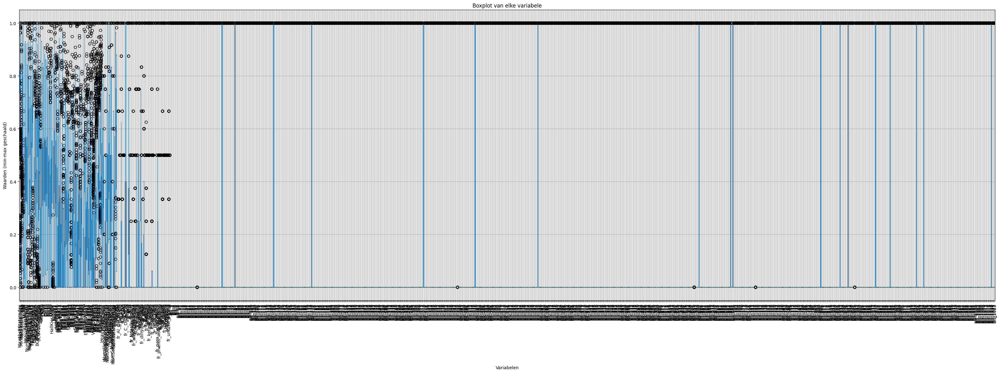

In [10]:
# plotten van min-max scaled values
plt.figure(figsize=(40, 12))
scaled_df.boxplot(rot=90)
plt.title('Boxplot van elke variabele')
plt.ylabel('Waarden (min-max geschaald)')
plt.xlabel('Variabelen')
plt.show()

In [11]:
# Hier moeten nog de outliers uitgehaald worden
# Function to calculate number of outliers in a column
def count_outliers(column):
    Q1 = column.quantile(0.25)
    Q3 = column.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = ((column < lower_bound) | (column > upper_bound)).sum()
    return outliers

# Apply the function to each column
outliers_per_column = expanded_df.iloc[:, 1:].apply(count_outliers)
print("Number of outliers per column:")
print(outliers_per_column)

Number of outliers per column:
MaxAbsEStateIndex    145
MaxEStateIndex       145
MinAbsEStateIndex     93
MinEStateIndex       239
qed                    2
                    ... 
Bit_1019               0
Bit_1020               8
Bit_1021              27
Bit_1022               9
Bit_1023              13
Length: 1211, dtype: int64


In [12]:
# # Monique toegevoegd

# #scale data via standardize
# from sklearn.preprocessing import StandardScaler

# df = expanded_df.iloc[:,3:]

# scaler_standardize = StandardScaler()
# scaled_data_standardize = scaler_standardize.fit_transform(df)

# # scale data via minmax scaler
# scaler = MinMaxScaler()
# scaled_data = scaler.fit_transform(df)

# use PCA
pca = PCA()
#pca.fit(scaled_data)
pca.fit(scaled_df)

# pca1 = PCA()
# pca1.fit(scaled_data_standardize)


PCA()

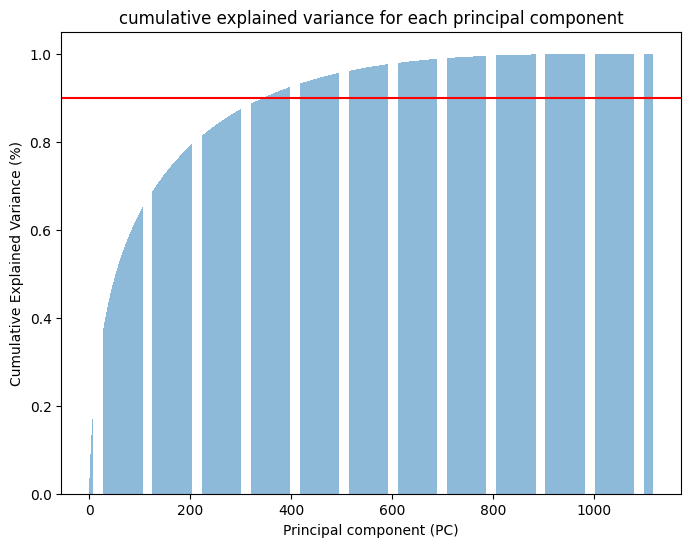

In [13]:
# MinMaxScaler

cumulative_variance = np.cumsum(pca.explained_variance_ratio_)

plt.figure(figsize=(8, 6))
plt.bar(range(1, len(cumulative_variance) + 1), cumulative_variance, alpha=0.5, align='center')

plt.axhline(y=0.9,color='r',linestyle='-')
plt.xlabel('Principal component (PC)')
plt.ylabel('Cumulative Explained Variance (%)')
plt.title('cumulative explained variance for each principal component')

plt.show()

In [14]:
# # Standardization scaler
# cumulative_variance1 = np.cumsum(pca1.explained_variance_ratio_)

# plt.figure(figsize=(8, 6))
# plt.bar(range(1, len(cumulative_variance1) + 1), cumulative_variance1, alpha=0.5, align='center')

# plt.axhline(y=0.9,color='r',linestyle='-')
# plt.xlabel('Principal component (PC)')
# plt.ylabel('Cumulative Explained Variance (%)')
# plt.title('cumulative explained variance for each principal component')

# plt.show()

In [15]:
# Kijken welke het belangrijkste is in pc1
important_idx = np.argmax(np.abs(pca.components_[0]))
important_feature = scaled_df.columns[important_idx]
important_feature

'Bit_893'

In [16]:
# Kijken welke het minst belangrijkste is
important_idx = np.argmin(np.abs(pca.components_[0]))
important_feature = scaled_df.columns[important_idx]
important_feature

'Bit_192'

In [17]:
# Nummer of Principal Components bij MinMaxScaling
num_components = np.argmax(cumulative_variance >= 0.80) + 1
num_components

210

In [18]:
# num_components = np.argmax(cumulative_variance1 >= 0.80) + 1
# num_components

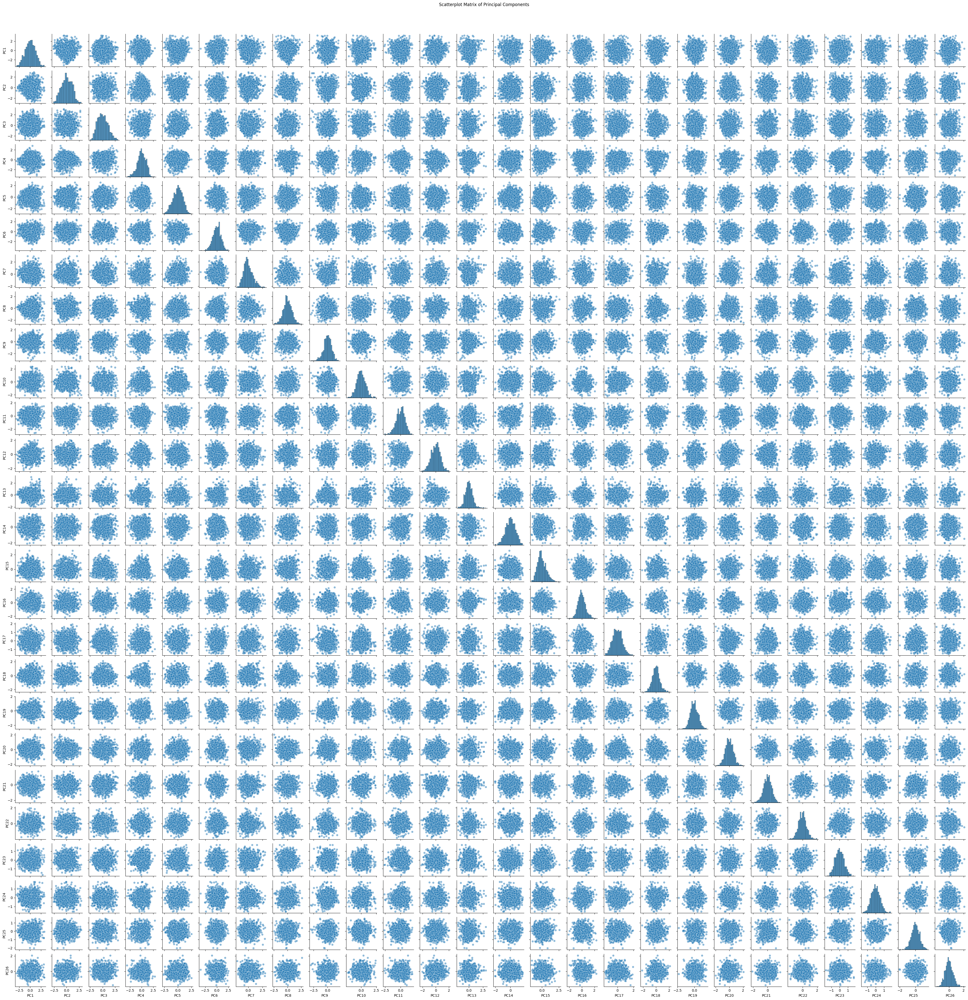

In [19]:
#Met deze code krijg je een mega plot waarin alle scores per principal component zijn uitgezet, zie slide 55 van college op 27 mei
pca1 = PCA(n_components=26)

pca_scores = pca1.fit_transform(scaled_df)

pca_df = pd.DataFrame(pca_scores, columns=[f'PC{i+1}' for i in range(26)])

sns.pairplot(pca_df, plot_kws={'alpha': 0.5}, height=1.5)
plt.suptitle('Scatterplot Matrix of Principal Components', y=1.02)
plt.show()

#  DIT ZEGT NIETS, WE MOETEN DE VARIABELEN TEGEN ELKAAR PLOTTEN WANT DAAR IS ENKEL EEN VERBAND UIT TE HALEN :)


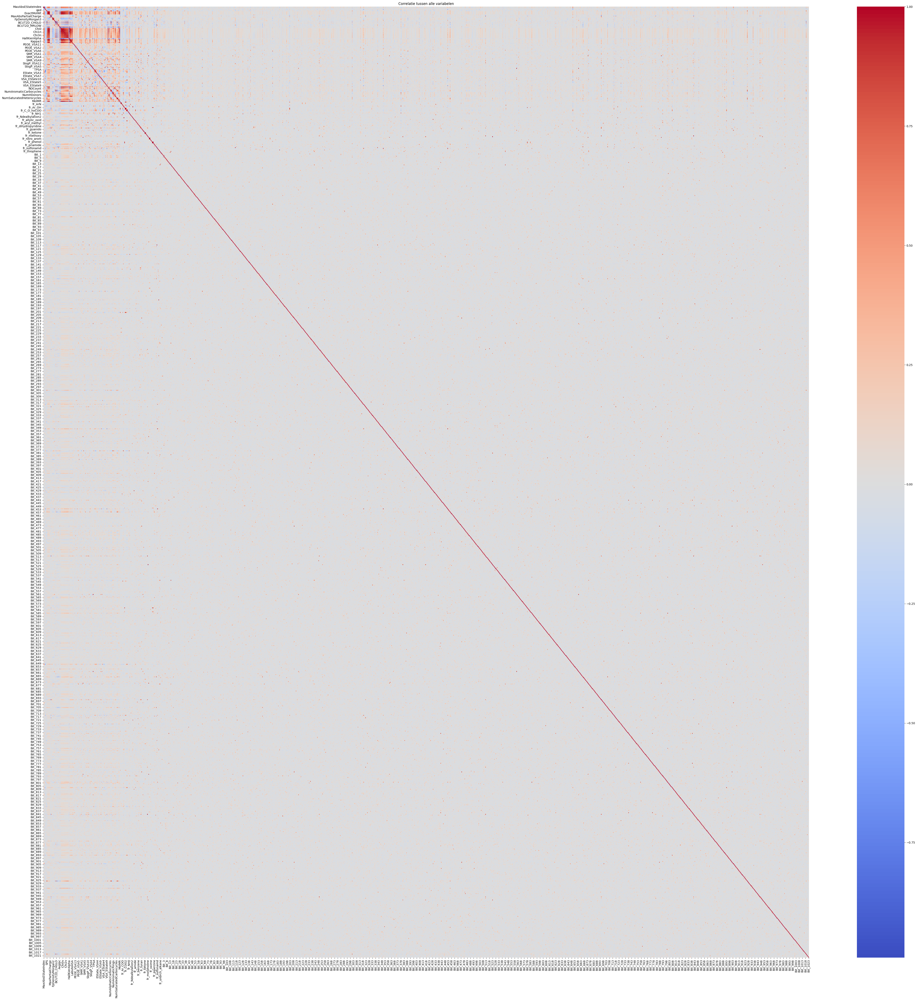

In [20]:
# voor spearman gekozen want geen normality assumed
correlation_matrix = expanded_df.iloc[:,1:].corr(method = 'spearman')

# Maak de heatmap
plt.figure(figsize=(60, 60))
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=False)
plt.title('Correlatie tussen alle variabelen')
plt.show()

# wij denken dat een zo laag mogelijke correlatie beter is, omdat sterk gerelateerde variabelen geen extra informatie geven

In [21]:
## GEEFT DE TOP 4 BELANGRIJSKTE FEATURES VOOR DE EERSTE 26 PCs

# Apply PCA with the desired number of components
n_components = 26  # Adjust as necessary for your data
pca = PCA(n_components=n_components)
pca.fit(scaled_df)

# Extract loadings
loadings = pca.components_.T

# Create a DataFrame for better visualization
loadings_df = pd.DataFrame(loadings, columns=[f'PC{i+1}' for i in range(n_components)], index=scaled_df.columns)

# # Print the loadings
# print("Loadings for the first 26 Principal Components:")
# print(loadings_df)

# Determine the most important features for each principal component
top_features = loadings_df.apply(lambda x: x.abs().nlargest(4).index, axis=0)
print("\nMost important features for each of the first 26 principal components:")
print(top_features)


Most important features for each of the first 26 principal components:
       PC1      PC2      PC3      PC4      PC5       PC6      PC7      PC8  \
0  Bit_893  Bit_926  Bit_378  Bit_128  Bit_175    Bit_64  Bit_656  Bit_792   
1  Bit_926  Bit_695  Bit_935  Bit_893   Bit_64  Bit_1019  Bit_175  Bit_452   
2  Bit_807  Bit_456  Bit_831  Bit_512  Bit_350   Bit_175  Bit_902  Bit_350   
3  Bit_695  Bit_841  Bit_175  Bit_695  Bit_452    Bit_80  Bit_314  Bit_926   

        PC9     PC10  ...     PC17     PC18     PC19     PC20     PC21  \
0  Bit_1019  Bit_314  ...  Bit_831  Bit_197  Bit_128  Bit_428  Bit_730   
1    Bit_80  Bit_875  ...  Bit_147  Bit_675  Bit_946  Bit_361  Bit_428   
2   Bit_666  Bit_698  ...  Bit_656  Bit_191  Bit_361   Bit_90  Bit_904   
3   Bit_705  Bit_656  ...  Bit_121  Bit_843  Bit_333  Bit_322   Bit_42   

       PC22     PC23     PC24     PC25     PC26  
0    Bit_90  Bit_875  Bit_831  Bit_361   Bit_90  
1   Bit_715  Bit_333  Bit_294  Bit_935  Bit_842  
2  Bit_1019  Bit

In [22]:
## LAAT ZIEN WAT DE HOOGSTE LOADINGS ZIJN VOOR DE EERSTE 3 PCs (hiermee hebben we besloten dat 4 features per PC genoeg is)

# Select only the PC1 column from the loadings DataFrame
pc1_loadings = loadings_df['PC1']

# Sort the loadings by absolute value from highest to lowest
pc1_loadings_sorted = pc1_loadings.abs().sort_values(ascending=False)

# Print the sorted loadings for PC1
print("Loadings for PC1 sorted by absolute value (from highest to lowest):")
print(pc1_loadings[pc1_loadings_sorted.index][0:10])

print()

# Select only the PC1 column from the loadings DataFrame
pc2_loadings = loadings_df['PC2']

# Sort the loadings by absolute value from highest to lowest
pc2_loadings_sorted = pc2_loadings.abs().sort_values(ascending=False)

# Print the sorted loadings for PC2
print("Loadings for PC2 sorted by absolute value (from highest to lowest):")
print(pc2_loadings[pc2_loadings_sorted.index])

print()

# Select only the PC1 column from the loadings DataFrame
pc3_loadings = loadings_df['PC3']

# Sort the loadings by absolute value from highest to lowest
pc3_loadings_sorted = pc3_loadings.abs().sort_values(ascending=False)

# Print the sorted loadings for PC2
print("Loadings for PC3 sorted by absolute value (from highest to lowest):")
print(pc3_loadings[pc3_loadings_sorted.index])

Loadings for PC1 sorted by absolute value (from highest to lowest):
Bit_893    0.196691
Bit_926    0.177212
Bit_807    0.171521
Bit_695    0.158642
Bit_650    0.150484
Bit_378   -0.146425
Bit_128    0.146185
Bit_841    0.132628
Bit_350    0.127824
Bit_456    0.127814
Name: PC1, dtype: float64

Loadings for PC2 sorted by absolute value (from highest to lowest):
Bit_926     0.304509
Bit_695    -0.264842
Bit_456     0.224115
Bit_841    -0.218721
Bit_128    -0.186753
              ...   
fr_oxime   -0.000013
Bit_331    -0.000008
Bit_27      0.000008
Bit_911    -0.000007
Bit_780     0.000003
Name: PC2, Length: 1211, dtype: float64

Loadings for PC3 sorted by absolute value (from highest to lowest):
Bit_378     0.262651
Bit_935     0.225009
Bit_831     0.163364
Bit_175     0.162690
Bit_140     0.162558
              ...   
Bit_897    -0.000023
Bit_951    -0.000018
Bit_199     0.000017
Bit_1015    0.000014
Bit_81     -0.000010
Name: PC3, Length: 1211, dtype: float64


In [23]:
## BEREKEND HOEVAAK ELKE FEATURE IS GENOEMD BIJ DE TOP 4 BELANGRIJKSTE FEATURES VOOR DE 26 PCs

# Initialize a dictionary to store the count of each feature
feature_count = {}

# Iterate over the top_features DataFrame
for i in range(1, n_components + 1):
    # Get the most important features for the ith principal component
    top_features_pc = top_features[f'PC{i}']
    
    # Update the count for each feature
    for feature in top_features_pc:
        if feature in feature_count:
            feature_count[feature] += 1
        else:
            feature_count[feature] = 1

# Convert the dictionary to a DataFrame for better visualization
feature_count_df = pd.DataFrame(feature_count.items(), columns=['Feature', 'Count'])

# Sort the DataFrame by count in descending order
feature_count_df = feature_count_df.sort_values(by='Count', ascending=False)

# Print the result
print("Count of each feature among the most important features for each of the first 26 principal components:")
print(feature_count_df)

Count of each feature among the most important features for each of the first 26 principal components:
     Feature  Count
30   Bit_428      5
25    Bit_90      4
37   Bit_361      4
35   Bit_904      4
8    Bit_831      4
9    Bit_175      4
19   Bit_314      4
15  Bit_1019      3
1    Bit_926      3
24   Bit_698      3
23   Bit_875      3
17   Bit_656      3
0    Bit_893      3
3    Bit_695      3
10   Bit_128      3
13   Bit_350      2
44   Bit_333      2
34   Bit_675      2
41   Bit_191      2
14   Bit_452      2
42   Bit_843      2
4    Bit_456      2
29   Bit_322      2
27   Bit_294      2
45   Bit_730      2
6    Bit_378      2
7    Bit_935      2
20   Bit_792      2
16    Bit_80      2
12    Bit_64      2
38   Bit_147      1
43   Bit_946      1
46    Bit_42      1
47   Bit_715      1
48   Bit_389      1
49   Bit_842      1
40   Bit_197      1
39   Bit_121      1
32   Bit_561      1
2    Bit_807      1
36   Bit_543      1
33   Bit_816      1
31   Bit_659      1
28   Bit_623     

In [24]:
## MAAKT DE NIEUWE DATA FRAME AAN (met de gevonden features hierboven)

# Extract the names of the most important features
important_features = feature_count_df['Feature'].tolist()

# Filter the original DataFrame to include only the important features
new_df = scaled_df[important_features]

# Print the new DataFrame
print("New DataFrame with only the important features:")
new_df.head(100)

New DataFrame with only the important features:


,Bit_428,Bit_90,Bit_361,Bit_904,Bit_831,Bit_175,Bit_314,Bit_1019,Bit_926,Bit_698,...,Bit_816,Bit_659,Bit_623,Bit_881,Bit_841,Bit_705,Bit_666,Bit_902,Bit_512,Bit_672
0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
96,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
97,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
98,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


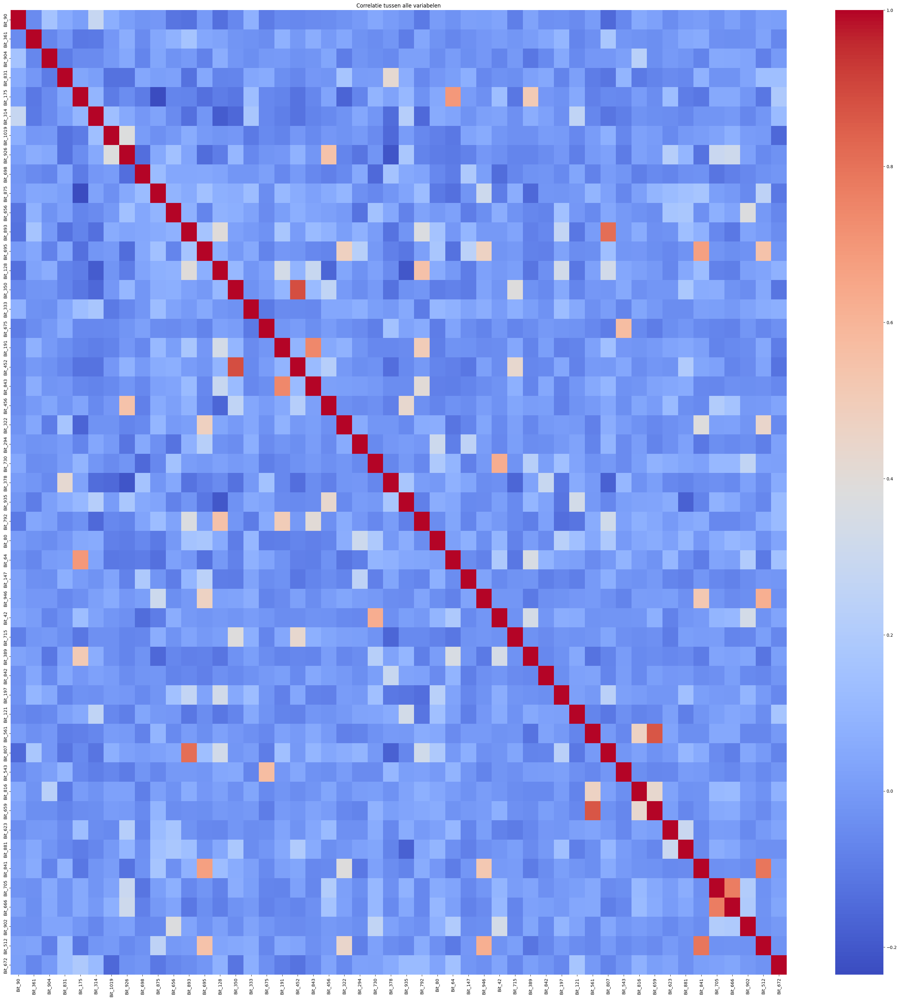

In [25]:
# voor spearman gekozen want geen normality assumed
correlation_matrix = new_df.iloc[:,1:].corr(method = 'spearman')

# Maak de heatmap
plt.figure(figsize=(40, 40))
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=False)
plt.title('Correlatie tussen alle variabelen')
plt.show()

#gooedddddd!!! --> machine learning it is

In [26]:
print(important_features)

# Filter the original DataFrame to include only the important features
df_67 = pd.DataFrame()
for column in important_features:
    df_67[column] = expanded_df[column]

# Print the new DataFrame
print("New DataFrame with only the important features:")
df_67.head(15)

['Bit_428', 'Bit_90', 'Bit_361', 'Bit_904', 'Bit_831', 'Bit_175', 'Bit_314', 'Bit_1019', 'Bit_926', 'Bit_698', 'Bit_875', 'Bit_656', 'Bit_893', 'Bit_695', 'Bit_128', 'Bit_350', 'Bit_333', 'Bit_675', 'Bit_191', 'Bit_452', 'Bit_843', 'Bit_456', 'Bit_322', 'Bit_294', 'Bit_730', 'Bit_378', 'Bit_935', 'Bit_792', 'Bit_80', 'Bit_64', 'Bit_147', 'Bit_946', 'Bit_42', 'Bit_715', 'Bit_389', 'Bit_842', 'Bit_197', 'Bit_121', 'Bit_561', 'Bit_807', 'Bit_543', 'Bit_816', 'Bit_659', 'Bit_623', 'Bit_881', 'Bit_841', 'Bit_705', 'Bit_666', 'Bit_902', 'Bit_512', 'Bit_672']
New DataFrame with only the important features:


,Bit_428,Bit_90,Bit_361,Bit_904,Bit_831,Bit_175,Bit_314,Bit_1019,Bit_926,Bit_698,...,Bit_816,Bit_659,Bit_623,Bit_881,Bit_841,Bit_705,Bit_666,Bit_902,Bit_512,Bit_672
0,0,0,0,0,1,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
1,1,0,0,0,0,0,1,0,0,1,...,0,1,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,1,1,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,1,0,0,0,...,0,1,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0
6,0,0,0,1,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,1,1,0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,1,0,0,1,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
